In [1]:
import sys
import pandas as pd
import numpy as np
import multianndata as mad
import cna
import scanpy as sc
from matplotlib import pyplot as plt
# from plotnine import (
#     ggplot,
#     aes,
#     stage,
#     geom_violin,
#     geom_point,
#     geom_line,
#     geom_boxplot,
#     guides,
#     scale_fill_manual,
#     theme,
#     theme_classic,
# )

In [2]:
# parameters
resolution = "major_cell_types"
analysis_name = "no_expr_pc_covars"
celltype = "Monocyte"

In [3]:
# read in the multi anndata with GeNA phenotype information 
madata = cna.read(
    f"/directflow/SCCGGroupShare/projects/blabow/tenk10k_phase1/data_processing/csa_qtl/output/multianndata/{resolution}/{analysis_name}/{celltype}_scDataObject.dimreduc.pca.gena_pheno.h5ad"
)

Only considering the two last: ['.gena_pheno', '.h5ad'].
Only considering the two last: ['.gena_pheno', '.h5ad'].


In [4]:
madata.obs

,id,sequencing_library,cohort,wg2_scpred_prediction,npheno_1:143272092:A:T,npheno_2:16395367:G:GACACACACACACCACACACACCTCACACACCACAGAGACACACACACCTCACACACCATAGAGACACACACACCTCACACACCATAGAGACACACACACCTCACACACCATAGAGAC,npheno_22:19725903:TCG:T,npheno_12:121634368:T:G,npheno_19:27243890:C:T,npheno_7:157482628:A:G,...,npheno_7:154660574:C:T,npheno_13:30844562:C:CTGTGGTGTGTATGTGGTGTGTGTATGTGGTGTGCGTGTA,npheno_5:17389869:A:G,npheno_3:194324909:A:G,npheno_4:91999093:TATTATATATATAA:T,npheno_1:205973148:G:GCACACCATGCACACACACACCCTTCACACCATGCACACACACACACCCTTCACACTGCACACCACACACACACACCACACATGCACACACTACATACCACACTGCACACCACACACACAT,npheno_4:158142186:C:A,npheno_1:144102833:G:GGCTTGGC,npheno_7:73578776:G:GAGGGGCGGGGCCTGGTTGTTAGAGCGCTTTGAAGGCGGGGCCTGGCCGTTAGAGCATCTCGAGGAGCGCAGCCTGGTTATTAGAGCAAGTCGAGGGGCGGAGCCTGGGTTAGAGCGCCTCGAGGGGCCGCGCCGGGTTGTTAGAGCGCCTCGAGGGGACGAACCCAGAGGCAGAGCGTCTCGAGGGGCGGGACCTGGTTGTTAGAGCGCCTGGAGGGACAGACTACGTTAGAGCGTCTCGAGGGGCGGGGCCTGGAGTTAGAACGGCTCC,npheno_19:40965436:AC:A
AAACGAAGTGTCGATT_S0056a,CPG247833,S0056a,BioHEART,CD16_Mono,0.042885,-0.036517,-0.019607,0.023065,0.013249,-0.019953,...,-0.014506,0.013502,-0.020266,-0.022958,0.016468,0.015052,-0.028242,0.005673,-0.026330,-0.047157
AAAGAACAGGGACTGT_S0056a,CPG248708,S0056a,BioHEART,CD14_Mono,0.087058,-0.049260,-0.067470,0.056251,0.080371,-0.071052,...,-0.019695,-0.014180,0.037464,0.050405,-0.048244,-0.033115,0.021939,-0.060479,-0.011586,-0.078026
AAAGGATGTGGCAGAT_S0056a,CPG248708,S0056a,BioHEART,CD14_Mono,0.184999,-0.195474,-0.182209,0.169330,0.169501,-0.161731,...,-0.108706,-0.085406,0.095349,0.111235,-0.119802,-0.112131,0.092646,-0.120183,-0.090224,-0.097986
AAAGGGCAGAGTTGTA_S0056a,CPG247833,S0056a,BioHEART,CD14_Mono,0.046604,-0.060723,-0.055546,0.026934,0.055143,-0.052097,...,0.001213,-0.052074,0.017598,0.051754,-0.034770,-0.030203,0.024016,-0.038494,-0.012452,-0.059613
AAAGGTACATTGAAAG_S0056a,CPG247833,S0056a,BioHEART,CD14_Mono,0.182839,-0.133048,-0.128156,0.131877,0.135141,-0.120831,...,-0.056612,-0.065913,0.090336,0.091597,-0.114290,-0.089496,0.085138,-0.086186,-0.060909,-0.090764
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TTTGTTGAGAAACCCG_S0176,CPG500348,S0176,BioHEART,CD14_Mono,-0.300049,0.252872,0.252534,-0.197017,-0.201003,0.217184,...,0.118189,0.116792,-0.090239,-0.158034,0.123571,0.114451,-0.118900,0.107822,0.114640,0.148318
TTTGTTGCAGTAGTTC_S0176,CPG500025,S0176,BioHEART,CD14_Mono,-0.254389,0.186091,0.220243,-0.181394,-0.197194,0.175242,...,0.112631,0.120948,-0.100883,-0.137708,0.091544,0.113829,-0.114358,0.120427,0.090165,0.151830
TTTGTTGCAGTCAGCC_S0176,CPG500249,S0176,BioHEART,CD14_Mono,-0.300166,0.245140,0.276333,-0.214681,-0.231646,0.221612,...,0.138419,0.152707,-0.121375,-0.142093,0.121342,0.149135,-0.137154,0.141561,0.125991,0.124579
TTTGTTGGTGCTGCAC_S0176,CPG500082,S0176,BioHEART,CD14_Mono,-0.263297,0.208134,0.216258,-0.204851,-0.204938,0.194325,...,0.140640,0.121705,-0.127148,-0.115258,0.100853,0.131587,-0.133345,0.125963,0.114633,0.128197


/directflow/SCCGGroupShare/projects/blabow/.conda/envs/gena-env/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/directflow/SCCGGroupShare/projects/blabow/.conda/envs/gena-env/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


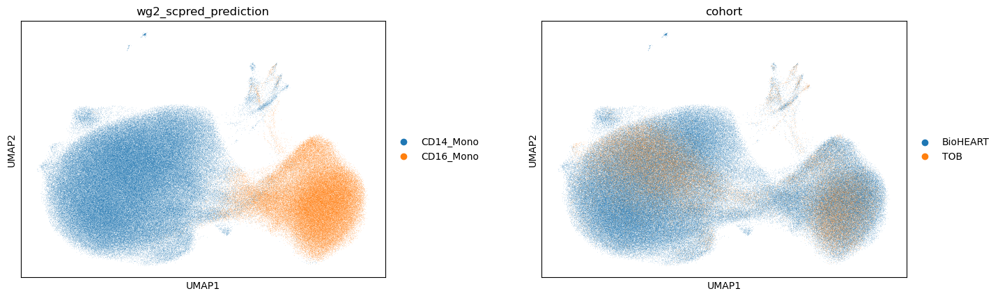

In [5]:
# plot neighbourhood abundance correllations

sc.pl.umap(
    madata,
    color=["wg2_scpred_prediction", "cohort"],
    wspace=0.3,
)

In [8]:
with plt.rc_context({"figure.figsize": (5, 5)}):
    sc.pl.umap(
        madata,
        color=["wg2_scpred_prediction", "cohort"] + madata.obs.columns[4:].tolist(),
        frameon=False,
        ncols=4,
    )

/directflow/SCCGGroupShare/projects/blabow/.conda/envs/gena-env/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/directflow/SCCGGroupShare/projects/blabow/.conda/envs/gena-env/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


Case example:

/directflow/SCCGGroupShare/projects/blabow/.conda/envs/gena-env/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/directflow/SCCGGroupShare/projects/blabow/.conda/envs/gena-env/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


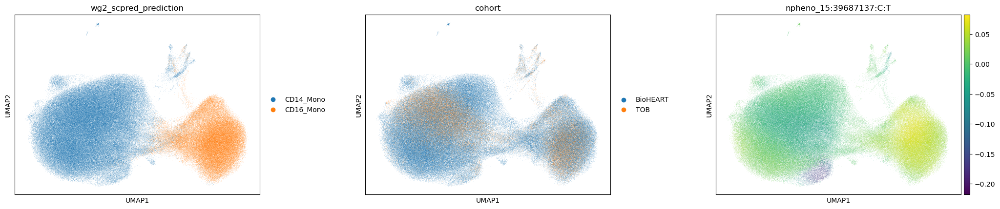

In [9]:
sc.pl.umap(
    madata,
    color=["wg2_scpred_prediction", "cohort", "npheno_15:39687137:C:T"],
    wspace=0.3,
)

# Validation - replicating Onek1k csaQTLs

/directflow/SCCGGroupShare/projects/blabow/.conda/envs/gena-env/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


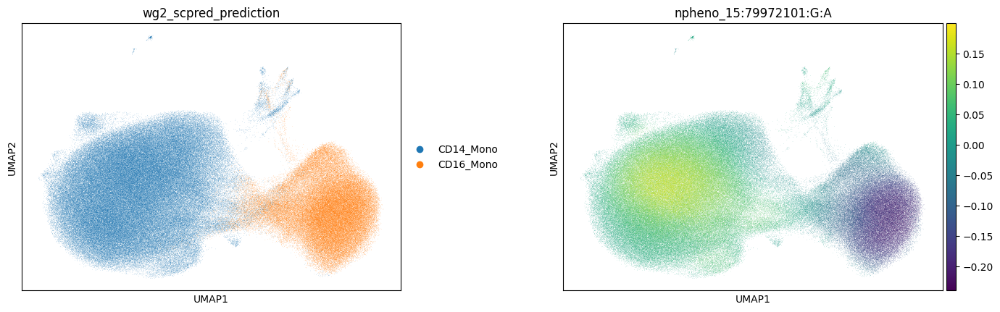

In [ ]:
onek1k_intersecting_myeloid = [
    "npheno_15:79972101:G:A",
]
sc.pl.umap(
    madata,
    color=["wg2_scpred_prediction"] + onek1k_intersecting_myeloid,
    wspace=0.3,
)

Here we can see replication of the csaQTL discovered in the onek1k cohort. This is most obvious for 15:79972101:G:A, where the alternate allele is associated with depletion of the CD16 monocytes. 

# explore csaQTL that are intersecting with cell type specific eQTL     


/directflow/SCCGGroupShare/projects/blabow/.conda/envs/gena-env/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


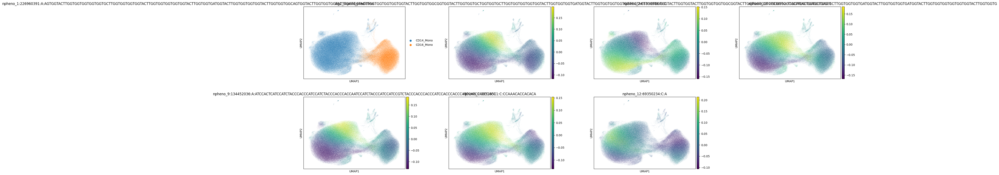

In [ ]:
intersecting_eqtl_list = [
    "npheno_1:226960391:A:AGTGGTACTTGGTGGTGGTGGTGGTGCTTGGTGGTGGTGGTACTTGGTGGTGGTGGTGGTACTTGGTGGTGATGGTACTTGGTGGTGGTGGTACTTGGTGGTGGCAGTGGTACTTGGTGGTGGTACTTGGTGGTACTTGGTGGTGGTGGTGGTACTTGGTGGTGGCGGTGGTACTTGGTGGTGCTGGTGGTGCTTGGTGGTGGTGGTGGTACTTGGTGGTGGTGATGGTACTTGGTGGTGGTGGTGGTGGTACTTGGTGGTGGTACTTGGTGGTACTTGGTGGTGGTGGCGGTACTTGGTGGTGGTGGCGGTGGCACTTGGTGGTGGTGGTGCTTGGTGGTGGTGATGGTACTTGGTGGTGGTGATGGTACTTGGTGGTGGTGGTGGTGGTACTTGGTGGTG",
    "npheno_2:65338986:G:C",
    "npheno_18:77036952:TTGGAGACTGAGCTGAG:T",
    "npheno_9:134452036:A:ATCCACTCATCCATCTACCCACCCATCCATCTACCCACCCACCAATCCATCTACCCATCCATCCGTCTACCCACCCACCCATCCACCCACCCATCCATCCACCCACC",
    "npheno_7:36515511:C:CCAAACACCACACA",
    "npheno_12:69350234:C:A"
]

sc.pl.umap(
    madata,
    color=["wg2_scpred_prediction"] + intersecting_eqtl_list,
    wspace=0.3,
)

In [ ]:
madata.samplem.columns

In [ ]:
madata.samplem

,sex,age,geno_PC1,geno_PC2,geno_PC3,geno_PC4,geno_PC5,geno_PC6,geno_PC7,geno_PC8,...,spheno_7:154660574:C:T,spheno_13:30844562:C:CTGTGGTGTGTATGTGGTGTGTGTATGTGGTGTGCGTGTA,spheno_5:17389869:A:G,spheno_3:194324909:A:G,spheno_4:91999093:TATTATATATATAA:T,spheno_1:205973148:G:GCACACCATGCACACACACACCCTTCACACCATGCACACACACACACCCTTCACACTGCACACCACACACACACACCACACATGCACACACTACATACCACACTGCACACCACACACACAT,spheno_4:158142186:C:A,spheno_1:144102833:G:GGCTTGGC,spheno_7:73578776:G:GAGGGGCGGGGCCTGGTTGTTAGAGCGCTTTGAAGGCGGGGCCTGGCCGTTAGAGCATCTCGAGGAGCGCAGCCTGGTTATTAGAGCAAGTCGAGGGGCGGAGCCTGGGTTAGAGCGCCTCGAGGGGCCGCGCCGGGTTGTTAGAGCGCCTCGAGGGGACGAACCCAGAGGCAGAGCGTCTCGAGGGGCGGGACCTGGTTGTTAGAGCGCCTGGAGGGACAGACTACGTTAGAGCGTCTCGAGGGGCGGGGCCTGGAGTTAGAACGGCTCC,spheno_19:40965436:AC:A
id,,,,,,,,,,,,,,,,,,,,,
CPG247833,2.0,49.0,0.005832,0.011282,0.000381,0.012024,0.008526,-0.002930,-0.035403,0.006086,...,-0.071243,-0.078641,0.078780,0.073436,-0.094077,-0.076518,0.079299,-0.080916,-0.074662,-0.147593
CPG248708,1.0,59.0,0.120278,0.109528,0.092017,0.116055,-0.031580,0.003927,0.034910,0.018746,...,0.059387,0.043053,-0.041831,NaN,0.048058,0.041658,-0.043928,0.035469,0.049594,-0.032754
CPG248245,1.0,51.0,0.008697,0.011537,0.007475,0.010963,0.008445,-0.005821,-0.020976,0.003033,...,-0.206022,-0.203418,0.203184,0.192695,-0.223349,-0.202111,0.206453,-0.202004,-0.203109,-0.176473
CPG247858,2.0,69.0,0.044986,0.052252,0.029080,0.046873,-0.006097,-0.004978,-0.008315,0.016663,...,0.039726,0.091570,-0.095382,-0.022355,0.159798,0.081346,-0.092077,0.115809,0.068912,-0.065740
CPG249003,2.0,60.0,0.000956,0.012564,-0.001645,0.008171,0.012879,-0.003057,-0.031736,0.011326,...,-0.061825,-0.073295,0.073804,0.114872,-0.092887,-0.070439,0.073872,-0.077619,-0.067660,-0.184569
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CPG508150,1.0,74.0,-0.003713,0.001856,0.000541,-0.000084,0.006606,-0.000956,-0.011250,0.003460,...,0.092844,0.092864,-0.092893,0.014548,NaN,0.093201,-0.094339,0.092477,0.092590,-0.127676
CPG500082,1.0,54.0,-0.000092,0.004406,0.001033,-0.000681,0.006846,-0.002957,-0.021973,0.004774,...,0.280648,0.277736,-0.277663,-0.685038,0.310524,0.277127,-0.282175,0.276093,0.277802,0.490520
CPG500249,1.0,59.0,-0.006509,0.001157,-0.003340,-0.001321,0.005336,0.002344,-0.006785,0.004892,...,0.247624,0.242282,-0.242074,-0.298129,0.268507,0.242673,-0.246266,0.239546,0.243605,0.280997


In [ ]:
sample_pheno

,spheno_2:65338986:G:C,2:65338986:G:C,Genotype
id,,,
CPG247833,0.031440,0.0,G/G
CPG248708,0.030450,1.0,G/C
CPG248245,0.321165,1.0,G/C
CPG247858,-0.084535,0.0,G/G
CPG249003,0.092440,0.0,G/G
...,...,...,...
CPG508150,-0.093167,0.0,G/G
CPG500082,-0.655655,0.0,G/G
CPG500249,-0.200953,0.0,G/G


In [ ]:
variant = "2:65338986:G:C"

sample_pheno = madata.samplem[[f"spheno_{variant}", variant]]

# Convert dosage from numeric encoding to actual genotypes
# genotypes_dict = {v: v.split(":")[2:4] for v in variant_id_list}

def geno_to_letters(ref, alt, geno):
    if geno == 0:
        out = f"{ref}/{ref}"
    elif geno == 1:
        out = f"{ref}/{alt}"
    elif geno == 2:
        out = f"{alt}/{alt}"
    elif geno == -9 or np.isnan(geno):
        out = "Missing genotype"
    else:
        raise ValueError(f"Unexpected genotype value: {geno}")
    return out

ref, alt = variant.split(":")[2:4]

sample_pheno["Genotype"] = [
    geno_to_letters(ref, alt, g) for g in sample_pheno[variant]
]

(
    ggplot(sample_pheno, aes(x="Genotype", y=f"spheno_{variant}")) + 
        geom_violin()
)

NameError: name 'madata' is not defined

In [ ]:
def csaqtl_boxplot(madata, variant_id_list):

    for variant in variant_id_list:
        variant = "2:111050100:G:A"
        sample_pheno = madata.samplem[[f"npheno_{variant}", variant]]
        sample_pheno.index = madata.uns["NAM_sampleXpc"].index

        # Convert dosage from numeric encoding to actual genotypes
        genotypes_dict = {v: v.split(":")[2:4] for v in variant_id_list}

        def geno_to_letters(ref, alt, geno):
            if geno == 0:
                out = f"{ref}/{ref}"
            elif geno == 1:
                out = f"{ref}/{alt}"
            elif geno == 2:
                out = f"{alt}/{alt}"
            elif geno == -9:
                out = "Missing genotype"
            return out

        ref, alt = genotypes_dict[variant]

        sample_pheno["Genotype"] = [
            geno_to_letters(ref, alt, g) for g in sample_pheno[variant]
        ]

        plot_order = [f"{ref}/{ref}", f"{ref}/{alt}", f"{alt}/{alt}"]

        sns.set_theme(style="darkgrid")
        ax = sns.boxplot(
            data=sample_pheno,
            x=f"{variant}",
            y="Sample-level phenotype",
            showfliers=False,
            order=plot_order
        )
        ax = sns.swarmplot(
            data=sample_pheno,
            x=f"{variant}",
            y="Sample-level phenotype",
            color="grey",
            size=1,
            # order=plot_order,
        ).set(title=f"{celltype}, P = {P}, {permuted}")
        # plt.savefig(
        #     fname=f"{figdir}/{resolution}/boxplots/intersections_real_geno/{celltype}_{analysis_name}_{variant}_intersecting_curated_deficiency_genes_box_plot.png",
        #     dpi=300,
        # )
        # plt.clf()
        plt.show()